In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.ticker as ticker
mpl.rcParams.update({
    'font.family' : 'STIXGeneral',
    'mathtext.fontset' : 'stix',
    'font.size' : 17,
    'xtick.major.size' : 5.5 ,
    'xtick.minor.size' : 3 ,
    'xtick.major.width' : 1.2 ,
    'xtick.minor.width' : 1.2 ,
    'xtick.labelsize' : 15 ,
    'xtick.direction' : 'in' ,
    'xtick.top' : True ,
    'ytick.major.size' : 5.5 ,
    'ytick.minor.size' : 3 ,
    'ytick.major.width' : 1.2 ,
    'ytick.minor.width' : 1.2 ,
    'ytick.labelsize' : 15 ,
    'ytick.direction' : 'in' ,
    'xtick.major.pad' : 8 ,
    'xtick.minor.pad' : 8 ,
    'ytick.major.pad' : 5 ,
    'ytick.minor.pad' : 5 ,
    'ytick.right' : True ,
    'savefig.dpi' : 600 ,
    'axes.unicode_minus' : False ,
    'axes.linewidth' : 1.2 ,
    'lines.linewidth' : 1.5,
    'legend.frameon' : False,
    'legend.fontsize' : 13,
    'legend.handlelength' : 1.5
})

In [2]:
t = np.linspace(0, 40, 200)
w0 = 0.5

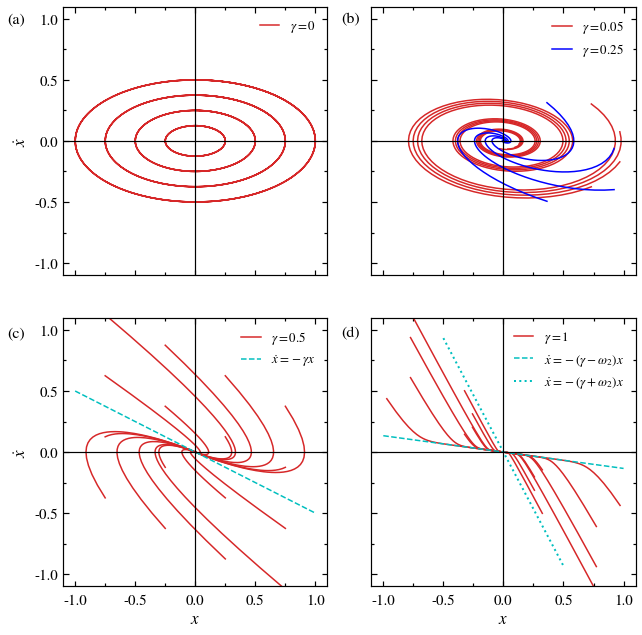

In [3]:
fig, ax = plt.subplots(2, 2, figsize=(9.1, 9.1), sharey=True, sharex=True)

for i in range (5):
    A = 0.25*i
    x = A*np.sin(w0*t)
    v = A*w0*np.cos(w0*t)
    l = ax[0,0].plot(x, v, '-',c='tab:red')
ax[0,0].set_ylim(-1.1, 1.1)
ax[0,0].set_xlim(-1.1, 1.1)
ax[0,0].legend(l, [r'$\gamma=0$'])

damp = 0.05
A = 1
w1 = np.sqrt(w0**2-damp**2)
for j in range (4):
    d = -0.75+0.5*j
    x = A*np.exp(-damp*t)*np.cos(w1*t-d)
    v = -A*np.exp(-damp*t)*(damp*np.cos(w1*t-d)+w1*np.sin(w1*t-d))
    l1 = ax[0,1].plot(x, v, '-',c='tab:red')
damp = 0.25
w1 = np.sqrt(w0**2-damp**2)
for j in range (4):
    d = -1.2+0.8*j
    x = A*np.exp(-damp*t)*np.cos(w1*t-d)
    v = -A*np.exp(-damp*t)*(damp*np.cos(w1*t-d)+w1*np.sin(w1*t-d))
    l2 = ax[0,1].plot(x, v, '-',c='blue')
ax[0,1].legend(l1+l2, [r'$\gamma=0.05$', r'$\gamma=0.25$'])

damp = 0.5
for i in range(4):
    for j in range (4):
        A = -0.75 + i*0.5
        B = -0.75 + j*0.5
        x = (A+B*t)*np.exp(-damp*t)
        v = np.exp(-damp*t)*(B-damp*(A+B*t))
        l1 = ax[1,0].plot(x, v, '-',c='tab:red')
l2 = ax[1,0].plot(np.linspace(-1, 1), -damp*np.linspace(-1, 1), 'c--')
ax[1,0].legend(l1+l2, [r'$\gamma=0.5$', r'$\dot{x}=-\gamma x$'])
        
damp = 1
w2 = np.sqrt(damp**2-w0**2)
for i in range (4):
    for j in range (4):
        A = -0.75+0.5*i
        d = -0.75+0.5*j
        x = A*np.exp(-damp*t)*np.cosh(w2*t-d)
        v = A*np.exp(-damp*t)*(w2*np.sinh(w2*t-d)-damp*np.cosh(w2*t-d))
        l1 = ax[1,1].plot(x, v, '-',c='tab:red')
l2 = ax[1,1].plot(np.linspace(-1, 1), -(damp-w2)*np.linspace(-1, 1), 'c--')
l3 = ax[1,1].plot(np.linspace(-0.5,0.5), -(damp+w2)*np.linspace(-0.5,0.5), 'c:', lw=2)
ax[1,1].legend(l1+l2+l3, [r'$\gamma=1$', r'$\dot{x}=-(\gamma-\omega_2) x$', r'$\dot{x}=-(\gamma+\omega_2) x$'])


for ax in ax.flat:
    ax.axvline(0, c='k', lw=1.2)
    ax.axhline(0, c='k', lw=1.2)
    ax.xaxis.set_minor_locator(ticker.MultipleLocator(0.25))
    ax.yaxis.set_minor_locator(ticker.MultipleLocator(0.25))
    ax.set(xlabel=r"$x$", ylabel=r"$\dot{x}$")
    ax.label_outer()
plt.tight_layout(pad=1, w_pad=2.5, h_pad=2.5)

fig.text(0.015, 0.95, '(a)', fontsize=16)
fig.text(0.525, 0.95, '(b)', fontsize=16)
fig.text(0.015, 0.47, '(c)', fontsize=16)
fig.text(0.525, 0.47, '(d)', fontsize=16)

plt.savefig("fig1.png")

## This one is what I used in report.

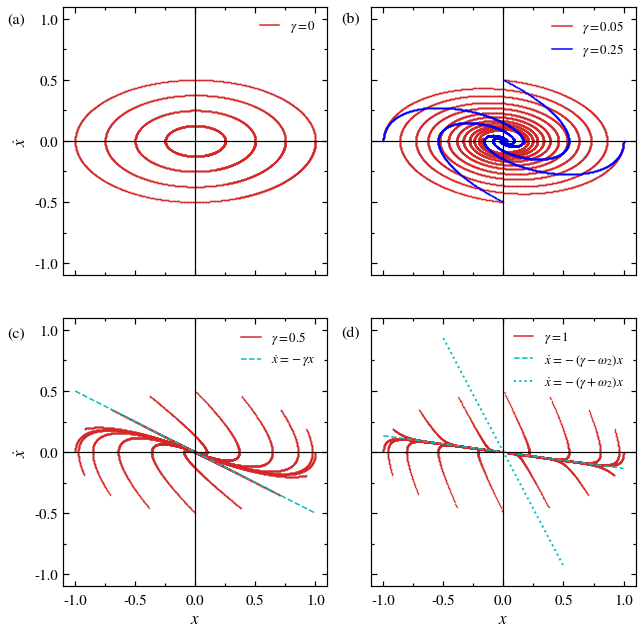

In [4]:
fig, ax = plt.subplots(2, 2, figsize=(9.1, 9.1), sharey=True, sharex=True)

w0=0.5
dt = 0.01

#a
for j in range (1, 5):
    x = 0.25*j
    v = 0
    for i in range (1500):
        a = -w0**2*x
        v = v+a*dt
        x = x+v*dt
        ax[0,0].plot(x, v, '.', ms=1, c='tab:red')
l = ax[0,0].plot(-5, -5, '-', c = 'tab:red')
ax[0,0].set_ylim(-1.1, 1.1)
ax[0,0].set_xlim(-1.1, 1.1)
ax[0,0].legend(l, [r'$\gamma=0$'])

#b
for x, v in [[1,0], [0,0.5], [-1,0], [0,-0.5]]:
    gamma=0.05
    for i in range (3500):
        a = -2*gamma*v-w0**2*x
        v = v+a*dt
        x = x+v*dt
        ax[0,1].plot(x, v, '.', ms=1, c='tab:red')
for x, v in [[1,0], [0,0.5], [-1,0], [0,-0.5]]:
    gamma=0.25
    for i in range (1500):
        a = -2*gamma*v-w0**2*x
        v = v+a*dt
        x = x+v*dt
        ax[0,1].plot(x, v, '.', ms=1, c='blue')
l1 = ax[0,1].plot(-5, -5, '-', c='tab:red')
l2 = ax[0,1].plot(5, 5, '-', c='b')
ax[0,1].legend(l1+l2, [r'$\gamma=0.05$', r'$\gamma=0.25$'])

#c
for i in range (16):
    phi = i*np.pi/8
    gamma=0.5
    x = np.cos(phi)
    v = 0.5*np.sin(phi)
    for i in range (1000):
        a = -2*gamma*v-w0**2*x
        v = v+a*dt
        x = x+v*dt
        ax[1,0].plot(x, v, '.', ms=1, c='tab:red')
l1 = ax[1,0].plot(5, 5, '-', c='tab:red')
l2 = ax[1,0].plot(np.linspace(-1, 1), -gamma*np.linspace(-1, 1), 'c--')
ax[1,0].legend(l1+l2, [r'$\gamma=0.5$', r'$\dot{x}=-\gamma x$'])
    
#d
for i in range (16):
    phi = i*np.pi/8
    gamma = 1
    x = np.cos(phi)
    v = 0.5*np.sin(phi)
    for i in range (1000):
        a = -2*gamma*v-w0**2*x
        v = v+a*dt
        x = x+v*dt
        ax[1,1].plot(x, v, '.', ms=1, c='tab:red')
l1 = ax[1,1].plot(5, 5, '-', c='tab:red')
l2 = ax[1,1].plot(np.linspace(-1, 1), -(gamma-w2)*np.linspace(-1, 1), 'c--', lw=1.5)
l3 = ax[1,1].plot(np.linspace(-0.5,0.5), -(gamma+w2)*np.linspace(-0.5,0.5), 'c:', lw=2)
ax[1,1].legend(l1+l2+l3, [r'$\gamma=1$', r'$\dot{x}=-(\gamma-\omega_2) x$', r'$\dot{x}=-(\gamma+\omega_2) x$'])
    
for ax in ax.flat:
    ax.axvline(0, c='k', lw=1.2)
    ax.axhline(0, c='k', lw=1.2)
    ax.xaxis.set_minor_locator(ticker.MultipleLocator(0.25))
    ax.yaxis.set_minor_locator(ticker.MultipleLocator(0.25))
    ax.set(xlabel=r"$x$", ylabel=r"$\dot{x}$")
    ax.label_outer()
plt.tight_layout(pad=1, w_pad=2.5, h_pad=2.5)

fig.text(0.015, 0.95, '(a)', fontsize=16)
fig.text(0.525, 0.95, '(b)', fontsize=16)
fig.text(0.015, 0.47, '(c)', fontsize=16)
fig.text(0.525, 0.47, '(d)', fontsize=16)

plt.savefig('fig1_add.png')

C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:33: RuntimeWarning: invalid value encountered in true_divide
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:33: RuntimeWarning: invalid value encountered in greater
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: invalid value encountered in true_divide
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: invalid value encountered in greater


29 48
29 48


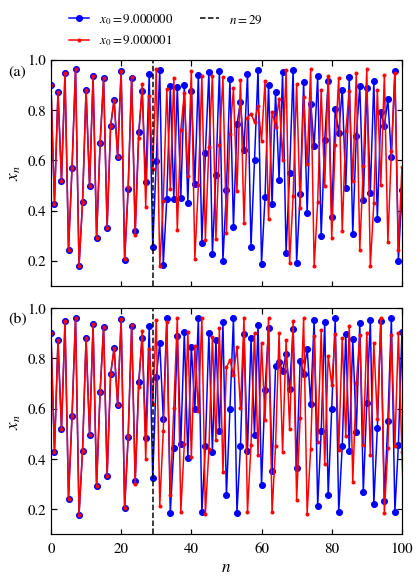

In [6]:
n = 100
a=2.5
fig, ax = plt.subplots(2,1, figsize=(6.4, 8), sharex=True, sharey = True)
a_32 = np.float32(a)
x1_32 = np.zeros(10000, dtype=np.float32)
x2_32 = np.zeros(10000, dtype=np.float32)
x1_32[0] = np.float32(0.9000000)
x2_32[0] = np.float32(0.9000001)
for i in range (n):
    x1_32[i+1] = a_32 * x1_32[i] * (1-x1_32[i]**2)
    x2_32[i+1] = a_32 * x2_32[i] * (1-x2_32[i]**2)
    
    
ax[0].plot(x1_32, 'bo-', label=r'$x_0=9.000000$')
ax[0].plot(x2_32, 'r.-', label=r'$x_0=9.000001$')
ax[0].set_xlim(0, n)
ax[0].set_ylim(0.1, 1)

a_64 = np.float64(a)
x1_64 = np.zeros(10000, dtype=np.float64)
x2_64 = np.zeros(10000, dtype=np.float64)
x1_64[0] = np.float64(0.9000000)
x2_64[0] = np.float64(0.9000001)
for i in range (n):
    x1_64[i+1] = a_64 * x1_64[i] * (1-x1_64[i]**2)
    x2_64[i+1] = a_64 * x2_64[i] * (1-x2_64[i]**2)
    
ax[1].plot(x1_64, 'bo-')
ax[1].plot(x2_64, 'r.-')

plt.tight_layout(pad = 2.2, h_pad=1)

print(np.argmax(np.abs(2*(x1_32-x2_32)/(x1_32+x2_32)) > 0.3), sum(np.abs(2*(x1_32-x2_32)/(x1_32+x2_32)) > 0.3))
print(np.argmax(np.abs(2*(x1_64-x2_64)/(x1_64+x2_64)) > 0.3), sum(np.abs(2*(x1_64-x2_64)/(x1_64+x2_64)) > 0.3))

l=ax[0].axvline(29, c='k', ls='--', label=r'$n=29$')
ax[1].axvline(29, c='k', ls='--')
ax[0].legend(bbox_to_anchor=(0.019, 1), ncol=2)
for ax in ax.flat:
    ax.set(xlabel=r"$n$", ylabel=r"$x_n$")
    ax.label_outer()
    
fig.text(0.04, 0.9, '(a)', fontsize=16)
fig.text(0.04, 0.47, '(b)', fontsize=16)
plt.savefig("fig2.png")

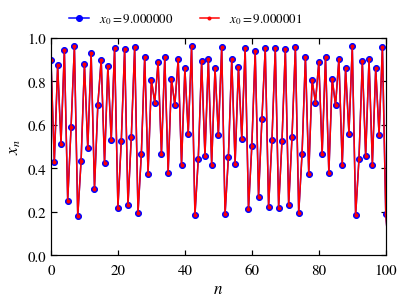

In [158]:
n = 100
a=2.5
a_16 = np.float16(a)
x1_16 = np.zeros(10000, dtype=np.float16)
x2_16 = np.zeros(10000, dtype=np.float16)
x1_16[0] = np.float16(0.9000000)
x2_16[0] = np.float16(0.9000001)
for i in range (n):
    x1_16[i+1] = a_16 * x1_16[i] * (1-x1_16[i]**2)
    x2_16[i+1] = a_16 * x2_16[i] * (1-x2_16[i]**2)
    
    
plt.plot(x1_16, 'bo-', label=r'$x_0=9.000000$')
plt.plot(x2_16, 'r.-', label=r'$x_0=9.000001$')
plt.xlim(0, n)
plt.ylim(0, 1)

plt.legend(bbox_to_anchor=(0.02, 1), ncol=2)
plt.xlabel(r"$n$")
plt.ylabel(r"$x_n$")
plt.savefig('fig2_add.png')

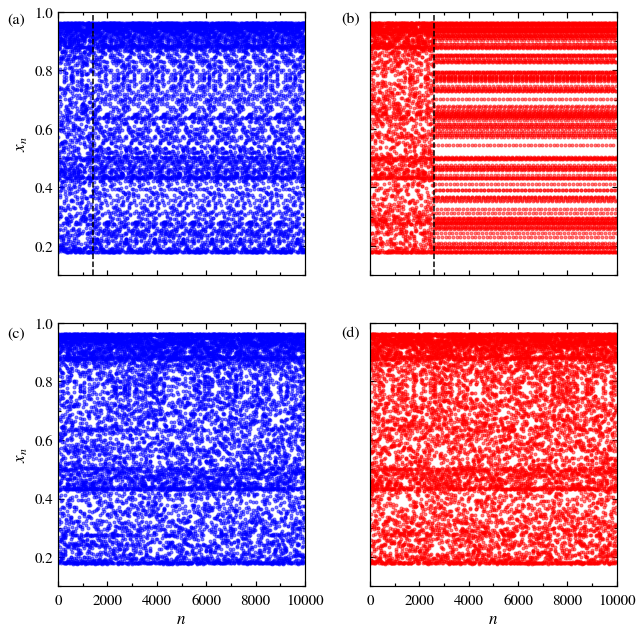

In [212]:
n = 10000
a=2.5
fig, ax = plt.subplots(2,2, figsize=(9.1,9.1), sharex=True, sharey = True)
a_32 = np.float32(a)
x1_32 = np.zeros(100000, dtype=np.float32)
x2_32 = np.zeros(100000, dtype=np.float32)
x1_32[0] = np.float32(0.9000000)
x2_32[0] = np.float32(0.9000001)
for i in range (n):
    x1_32[i+1] = a_32 * x1_32[i] * (1-x1_32[i]**2)
    x2_32[i+1] = a_32 * x2_32[i] * (1-x2_32[i]**2)


a_64 = np.float64(a)
x1_64 = np.zeros(100000, dtype=np.float64)
x2_64 = np.zeros(100000, dtype=np.float64)
x1_64[0] = np.float64(0.9000000)
x2_64[0] = np.float64(0.9000001)
for i in range (n):
    x1_64[i+1] = a_64 * x1_64[i] * (1-x1_64[i]**2)
    x2_64[i+1] = a_64 * x2_64[i] * (1-x2_64[i]**2)
      
ax[0,0].plot(x1_32, 'b.', alpha=0.5, label=r'$x_0=9.000000$')
ax[0,1].plot(x2_32, 'r.', alpha=0.5, label=r'$x_0=9.000001$')
ax[0,0].set_xlim(0, n)
ax[0,0].set_ylim(0.1, 1)  
ax[1,0].plot(x1_64, 'b.',alpha=0.5)
ax[1,1].plot(x2_64, 'r.',alpha=0.5)
ax[0,0].axvline(1430, c='k', ls='--')
ax[0,1].axvline(2580, c='k', ls='--')


#ax[0,0].legend(bbox_to_anchor=(0.02, 1), ncol=2)
for ax in ax.flat:
    ax.set(xlabel=r"$n$", ylabel=r"$x_n$")
    ax.xaxis.set_minor_locator(ticker.MultipleLocator(1000))
    ax.yaxis.set_minor_locator(ticker.MultipleLocator(0.1))
    ax.label_outer()
plt.tight_layout(pad=1, w_pad=2.5, h_pad=2.5)

fig.text(0.015, 0.95, '(a)', fontsize=16)
fig.text(0.525, 0.95, '(b)', fontsize=16)
fig.text(0.015, 0.47, '(c)', fontsize=16)
fig.text(0.525, 0.47, '(d)', fontsize=16)
plt.savefig("fig3.png")

C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in true_divide
  """Entry point for launching an IPython kernel.
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in greater
  """Entry point for launching an IPython kernel.


6246


C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in true_divide
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in greater
  


6149


C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in greater
  after removing the cwd from sys.path.
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in true_divide
  """
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in greater
  """


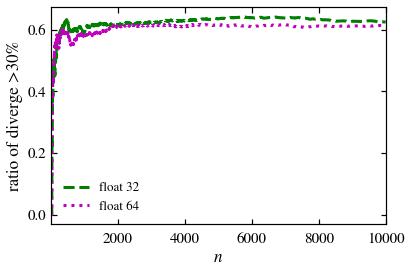

In [172]:
print(sum(np.abs(2*(x1_32-x2_32)/(x1_32+x2_32)) > 0.3))
print(sum(np.abs(2*(x1_64-x2_64)/(x1_64+x2_64)) > 0.3))
plt.xlim(1, n)
plt.plot(np.cumsum(np.abs(2*(x1_32-x2_32)/(x1_32+x2_32))/np.arange(1, 100001), 'g--', lw=3, label='float 32')
plt.plot(np.cumsum(np.abs(2*(x1_64-x2_64)/(x1_64+x2_64)) > 0.3)/np.arange(1, 100001), 'm:', lw=3, label='float 64')
plt.xlabel(r'$n$')
plt.ylabel('ratio of diverge >30%')
plt.legend(handlelength=2)
plt.savefig('fig4.png')

C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipyke

C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipyke

C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipyke

C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipyke

C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipyke

C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipyke

C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anacond

C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in double_scalars
  if __name__ == '__main__':
C:\Users\User\anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\User\anaconda3\lib\site-packages\ipyke

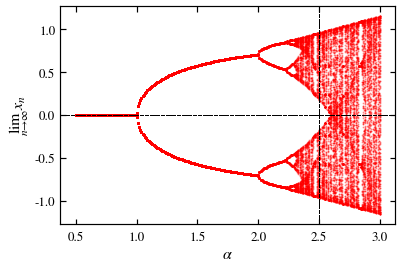

In [88]:
for i in range (550):
    alpha = np.float64(0.5+0.01*i)
    x1 = np.zeros(1000)
    x1[0] = np.float64(0.9000000)
    x2 = np.zeros(1000)
    x2[0] = np.float64(-0.9000000)
    for i in range (999):
        x1[i+1] = alpha * x1[i] * (1-x1[i]**2)
        x2[i+1] = alpha * x2[i] * (1-x2[i]**2)
    plt.plot(alpha*np.ones(100), x1[900:], 'r.', ms=2, alpha=0.3)
    plt.plot(alpha*np.ones(100), x2[900:], 'r.', ms=2, alpha=0.3)
    plt.xlabel(r'$\alpha$')
    plt.ylabel(r'$\lim_{n\to\infty}x_n$')
    plt.axvline(2.5, c='k', lw=1, ls='--')
    plt.axhline(0, c='k', lw=1, ls='--')
plt.savefig('bifurcation.png')

## Animation of $x_n$, with change in $\alpha$

MovieWriter imagemagick unavailable; trying to use <class 'matplotlib.animation.PillowWriter'> instead.


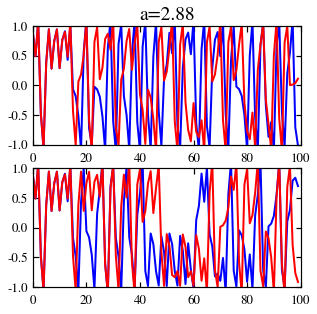

In [34]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
mpl.rcParams['animation.embed_limit'] = 2**128
n=100
fig = plt.figure(figsize=(4.8,4.8))
ax1 = fig.add_subplot(211, xlim=(0, n), ylim=(-1, 1))
ax2 = fig.add_subplot(212, xlim=(0, n), ylim=(-1, 1))
title=ax1.set_title("")
line1_32, = ax1.plot([], [], lw=2, c='b')
line2_32, = ax1.plot([], [], lw=2, c='r')
line1_64, = ax2.plot([], [], lw=2, c='b')
line2_64, = ax2.plot([], [], lw=2, c='r')
def init():
    line1_32.set_data([], [])
    line2_32.set_data([], [])
    line1_64.set_data([], [])
    line2_64.set_data([], [])
    title.set_text("")
    return (line1_32, line2_32, line1_64, line2_64, title)
def animate(i):
    a = 1.6+0.02*i
    title.set_text("a=%.2f"%a)
    a_64 = np.float64(a)
    x1_64 = np.ones(10000, dtype=np.float64)
    x2_64 = np.ones(10000, dtype=np.float64)
    x1_64[0] = np.float64(0.9000000)
    x2_64[0] = np.float64(0.9000001)
    a_32 = np.float32(a)
    x1_32 = np.ones(10000, dtype=np.float32)
    x2_32 = np.ones(10000, dtype=np.float32)
    x1_32[0] = np.float32(0.9000000)
    x2_32[0] = np.float32(0.9000001)
    for i in range (n):
        x1_32[i+1] = a_32 * x1_32[i] * (1-x1_32[i]**2)
        x2_32[i+1] = a_32 * x2_32[i] * (1-x2_32[i]**2)
        x1_64[i+1] = a_64 * x1_64[i] * (1-x1_64[i]**2)
        x2_64[i+1] = a_64 * x2_64[i] * (1-x2_64[i]**2)
    line1_32.set_data(np.arange(n), x1_32[:n])
    line2_32.set_data(np.arange(n), x2_32[:n])
    line1_64.set_data(np.arange(n), x1_64[:n])
    line2_64.set_data(np.arange(n), x2_64[:n])
    return (line1_32, line2_32, line1_64, line2_64, title) 
anim = FuncAnimation(fig, animate, init_func=init,
                     frames=65, interval=40, blit=True)
anim.save('prob2anim.gif', writer='imagemagick', fps=24, extra_args=['-vcodec', 'libx264'])
HTML(anim.to_jshtml())